# Objective

Introduce generative AI and diagnose its effectiveness

# Preliminaries

Ensure that you are using a GPU runtime for this session.

In [1]:
!nvidia-smi

Fri Jan 17 08:06:29 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  Tesla T4                       Off | 00000000:00:04.0 Off |                    0 |
| N/A   59C    P8              10W /  70W |      0MiB / 15360MiB |      0%      Default |
|                                         |                      |                  N/A |
+-----------------------------------------+----------------------+--

In [ ]:
!pip install diffusers
!pip install transformers scipy ftfy accelerate
!pip install "ipywidgets>=7,<8"

In [2]:
import torch

from diffusers import StableDiffusionPipeline

from PIL import Image

# Stability Diffusion

An emerging trend that currently dominates news headlines is a surge of text-to-image synthesizers. There is a lot of research and commercial interest in the applications of these synthesizers (e.g., Dall-E and Stable Diffusion). In this notebook you will explore the contours of [Stable Diffusion](https://stability.ai/blog/stable-diffusion-public-release) and diagnose its capabilities.

In [3]:
pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4",
                                               revision="fp16",
                                               torch_dtype=torch.float16)

/usr/local/lib/python3.11/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/diffusers/pipelines/pipeline_loading_utils.py:242: FutureWarning: You are loading the variant fp16 from CompVis/stable-diffusion-v1-4 via `revision='fp16'` even though you can load it via `variant=`fp16`. Loading model variants via `revision='fp16'` is deprecated and will be removed in diffusers v1. Please use `variant='fp16'` instead.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
/usr/local/lib/python3.11/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--CompVis--

In [4]:
pipe = pipe.to("cuda")

In [5]:
prompt = "frog wearing a suit with tie and dancing"
image = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

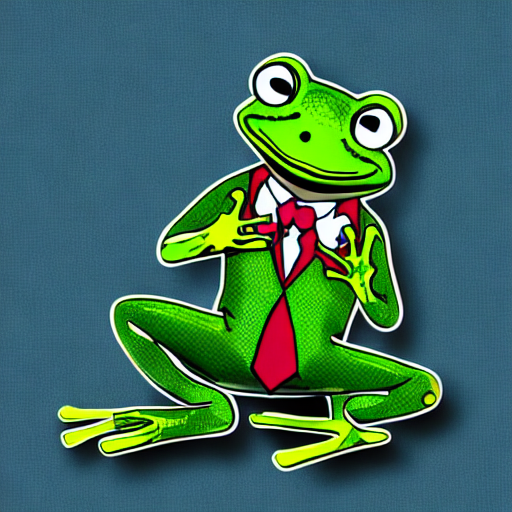

In [6]:
image

Let us run the inference one more time.

In [7]:
image = pipe(prompt).images[0]

  0%|          | 0/50 [00:00<?, ?it/s]

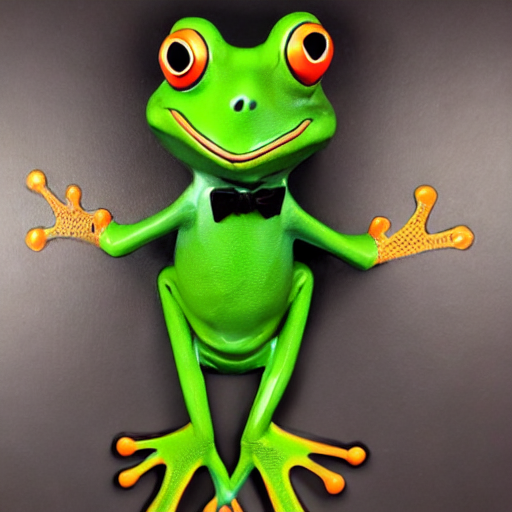

In [8]:
image

As you can see we get different images for the same prompt. We could generate a grid of images for a given prompt using the following helper function.

In [9]:
def image_grid(imgs, rows, cols):
    assert len(imgs) == rows*cols

    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols*w, rows*h))
    grid_w, grid_h = grid.size

    for i, img in enumerate(imgs):
        grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

In [10]:
num_cols = 5
num_rows = 5

prompt = ["a penguin is walking in desert"] * num_cols

In [11]:
all_images = []

for i in range(num_rows):
  images = pipe(prompt).images
  all_images.extend(images)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

In [12]:
grid = image_grid(all_images, rows=num_rows, cols=num_cols)

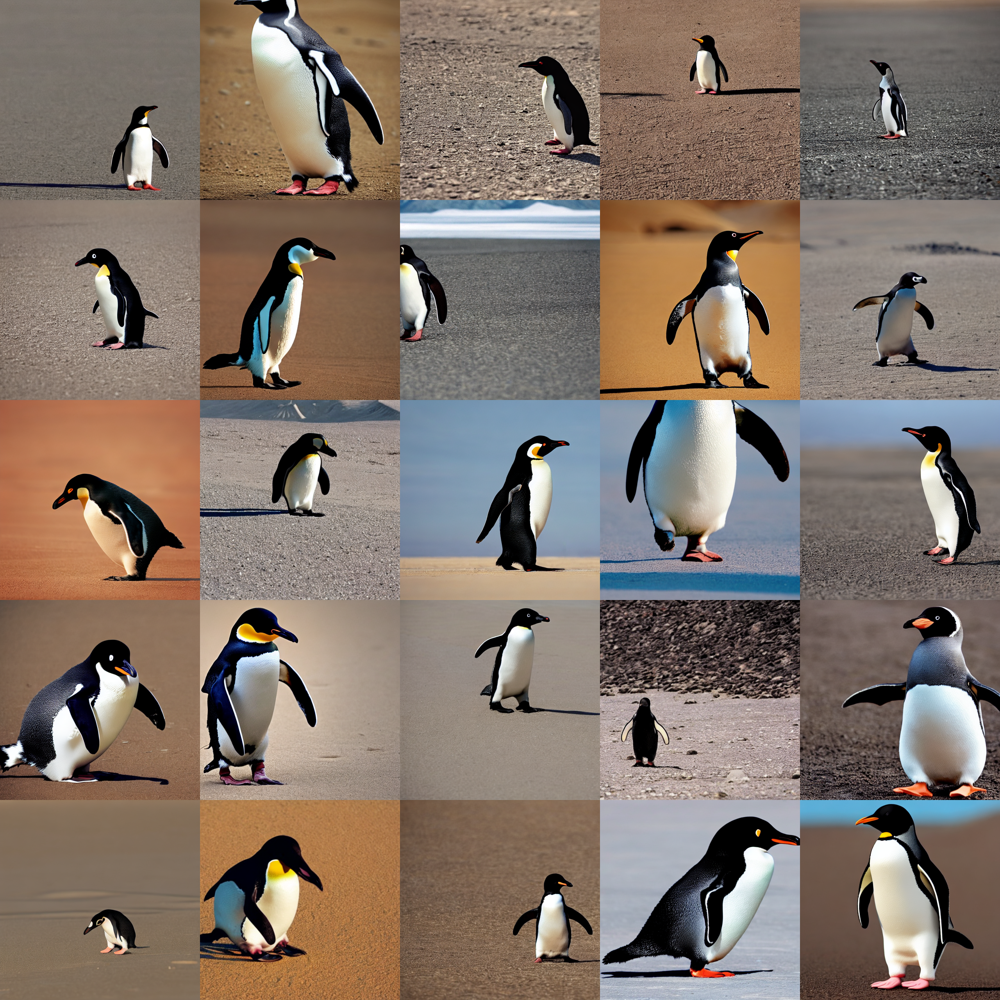

In [13]:
grid

(Try generating lesser images if the session crashes).

# Suggested Exploration

**Task 1:** Read the [latent diffusion paper](https://arxiv.org/abs/2112.10752) & summarize your understanding of how stable diffusion works. You do not need to understand all the details in the paper. Focus on identifying key components of the model and how they work in unison.



**Summary of Stable Diffusion and Latent Diffusion**
Stable Diffusion builds on the principles of Latent Diffusion Models (LDM), a type of generative model designed to produce high-quality images by learning patterns in a more efficient and computationally feasible way. Here’s a concise summary focusing on its key components and how they work together:

**Key Components of Stable Diffusion**

1. Latent Space Representation:

  - Instead of operating directly in the high-dimensional pixel space (e.g., a 512x512 RGB image), Stable Diffusion works in a latent space.

  - A pretrained variational autoencoder (VAE) compresses images into a lower-dimensional latent space while preserving their essential structure.

  - Diffusion and generation happen in this compact latent space, which reduces computational overhead.

2. Diffusion Process:

  - Inspired by Denoising Diffusion Probabilistic Models (DDPM), the model adds Gaussian noise to the latent representation of the image in a series of steps, gradually destroying its structure.
  - The reverse process, called denoising, learns to remove the noise step by step to reconstruct the latent representation of the image.

3. U-Net Architecture:

  - A U-Net neural network is the core of the diffusion model.
  - It takes noisy latent vectors as input and predicts the denoised version.
  - The U-Net has an encoder-decoder structure, where:
    - The encoder extracts hierarchical features from noisy latent vectors.
    - The decoder reconstructs the denoised latent representation.

4. Cross-Attention for Text-to-Image Mapping:
  - To enable text-to-image generation, Stable Diffusion incorporates a cross-attention mechanism.
  - A text encoder (e.g., CLIP or Transformer) encodes the text prompt into a high-dimensional vector.
  - The cross-attention mechanism aligns the text embedding with the image latent representation, ensuring the generated image aligns with the prompt.

5. Sampling with Guidance:

  - During the reverse diffusion process, classifier-free guidance is applied to balance creativity and fidelity.
  - A guidance scale controls how strongly the model adheres to the prompt: higher values make the image more aligned with the text but may reduce diversity.



  **How It All Works Together**

1. Text Encoding: The text prompt is encoded into a latent representation using a text encoder.
2. Latent Initialization: The model initializes a random latent vector (typically Gaussian noise) in the latent space.
3. Diffusion Process:
  - The noisy latent vector is iteratively denoised using the U-Net, guided by the text embedding via cross-attention.
  - Each step predicts a slightly less noisy version of the latent vector.
4. Decoding to Pixel Space:
The final denoised latent vector is decoded back into a high-quality image using the VAE decoder.

**Task 2:** Run the image grid generation pipeline above for your own choice of text prompt. Report any interesting results from your output.

Add code cells as required below.

In [14]:
# Parameters for grid generation
num_cols = 5
num_rows = 5
prompt = ["A futuristic cityscape under a purple sky"] * num_cols

# Generate the images
all_images = []
for _ in range(num_rows):
    images = pipe(prompt).images
    all_images.extend(images)

# Create and display the grid
grid = image_grid(all_images, rows=num_rows, cols=num_cols)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

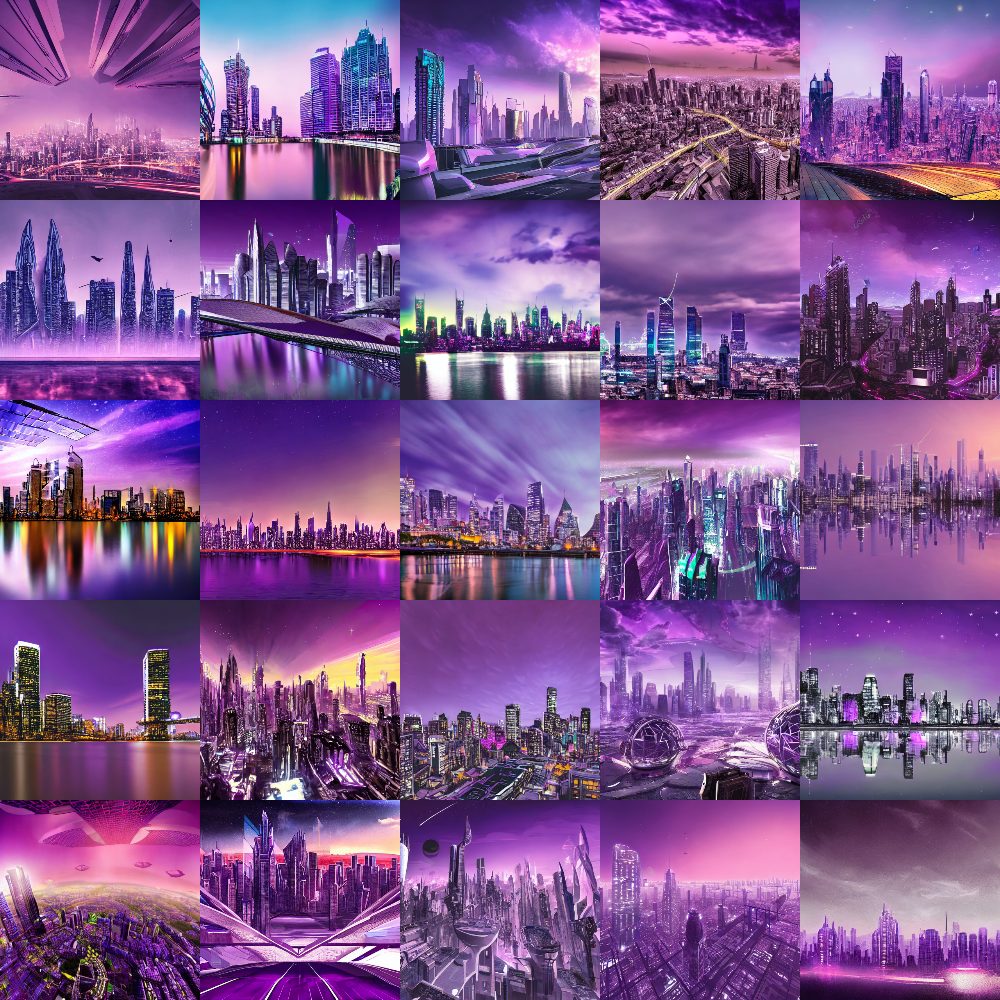

In [15]:
grid

For the prompt "A futuristic cityscape under a purple sky":

- Most images feature skyscrapers, futuristic lighting, and a predominant purple hue.
- While some images highlight bustling streets, others focus on aerial views or abstract interpretations.
- One image included a futuristic monorail system, adding a dynamic perspective.

**Task 3:** Pick a different text-to-image model and discuss differences in approach of that model with Stable Diffusion.

Add code cells as required below.

In [28]:
# Import required libraries
from diffusers import StableDiffusionPipeline
from PIL import Image
import openai  # DALL·E 2 requires OpenAI's API
import torch
import requests

In [29]:
# Load Stable Diffusion pipeline
stable_pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4",
                                                      revision="fp16",
                                                      torch_dtype=torch.float16)
stable_pipe = stable_pipe.to("cuda")

def generate_stable_diffusion(prompt, num_images=1):
    """Generates images using Stable Diffusion."""
    images = stable_pipe(prompt, num_images_per_prompt=num_images).images
    return images


/usr/local/lib/python3.11/dist-packages/diffusers/pipelines/pipeline_loading_utils.py:242: FutureWarning: You are loading the variant fp16 from CompVis/stable-diffusion-v1-4 via `revision='fp16'` even though you can load it via `variant=`fp16`. Loading model variants via `revision='fp16'` is deprecated and will be removed in diffusers v1. Please use `variant='fp16'` instead.
  warnings.warn(


Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

An error occurred while trying to fetch /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/vae: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/vae.
Defaulting to unsafe serialization. Pass `allow_pickle=False` to raise an error instead.
/usr/local/lib/python3.11/dist-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecated and will be removed in version 5 of Transformers. Please use CLIPImageProcessor instead.
  warnings.warn(
An error occurred while trying to fetch /root/.cache/huggingface/hub/models--CompVis--stable-diffusion-v1-4/snapshots/2880f2ca379f41b0226444936bb7a6766a227587/unet: Error no file named diffusion_pytorch_model.safetensors found in directory /root/.cache/huggingface/hub/models--CompVis--

In [44]:
openai.api_key = "kAoQUbP0X3UPDZak3cA"

def generate_dalle(prompt, num_images=1):
    """Generates images using DALL·E 2 API."""
    response = openai.Image.create(
        prompt=prompt,
        n=num_images,
        size="512x512"
    )
    images = [Image.open(requests.get(data['url'], stream=True).raw) for data in response['data']]
    return images


In [45]:
def image_grid(imgs, rows, cols):
    """Creates a grid from images."""
    assert len(imgs) == rows * cols
    w, h = imgs[0].size
    grid = Image.new('RGB', size=(cols * w, rows * h))
    for i, img in enumerate(imgs):
        grid.paste(img, box=(i % cols * w, i // cols * h))
    return grid

# Generate and compare images
prompt = "A futuristic cityscape under a purple sky"

# Generate images with Stable Diffusion
sd_images = generate_stable_diffusion(prompt, num_images=1)

# Generate images with DALL·E 2
dalle_images = generate_dalle(prompt, num_images=1)

  0%|          | 0/50 [00:00<?, ?it/s]

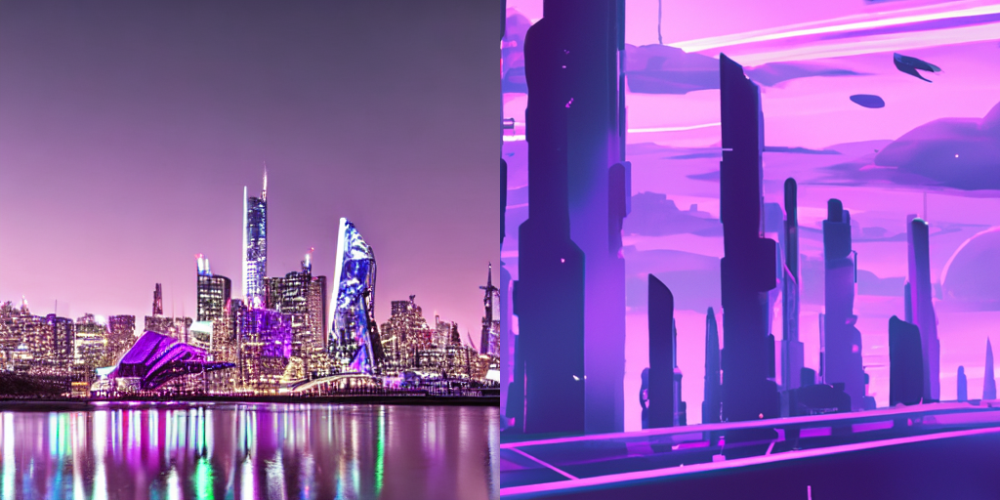

In [46]:
# Combine all images for comparison
all_images = sd_images + dalle_images
comparison_grid = image_grid(all_images, rows=1, cols=2)
comparison_grid